<a href="https://colab.research.google.com/github/marionaquinmor/image_explainability/blob/main/FINAL_Explicabilitat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **ESTUDI SOBRE L’APLICACIÓ DE TÈCNIQUES D’EXPLICABILITAT EN ALGORISMES D’INTEL·LIGÈNCIA ARTIFICIAL BASATS EN IMATGE MÈDICA**

# <a id="8">Importació de llibreries i imatges</a> 

In [ ]:
import pandas as pd       
import matplotlib as mat
import matplotlib.pyplot as plt    
import numpy as np
import seaborn as sns
%matplotlib inline

pd.options.display.max_colwidth = 100

import random
import os

from numpy.random import seed
seed(42)

random.seed(42)
os.environ['PYTHONHASHSEED'] = str(42)
os.environ['TF_DETERMINISTIC_OPS'] = '1'

from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import accuracy_score

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras import callbacks
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import glob
import cv2

from tensorflow.random import set_seed
set_seed(42)

import warnings
warnings.filterwarnings('ignore')
IMG_SIZE = 224
BATCH = 32
SEED = 42

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!unzip '/content/drive/MyDrive/Colab Notebooks/TFG/archive.zip'

Se han truncado las últimas 5000 líneas del flujo de salida.
  inflating: chest_xray/train/NORMAL/NORMAL-2558319-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2558319-0002.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2559035-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2559035-0002.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2565226-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2568157-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2597757-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2597757-0002.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-263932-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2646645-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2646923-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2655558-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2659844-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-2675017-0001.jpeg  
  inflating: chest_xray/train/NORMAL/NORMAL-

# <a id="8">Anàlisi de Dades</a> 

In [ ]:
main_path = "/content/chest_xray"


train_path = os.path.join(main_path,"train")
test_path=os.path.join(main_path,"test")

train_normal = glob.glob(train_path+"/NORMAL/*.jpeg")
train_pneumonia = glob.glob(train_path+"/PNEUMONIA/*.jpeg")

test_normal = glob.glob(test_path+"/NORMAL/*.jpeg")
test_pneumonia = glob.glob(test_path+"/PNEUMONIA/*.jpeg")

In [ ]:
# creació de dataframe amb les dades de train i test
train_list = [x for x in train_normal]
train_list.extend([x for x in train_pneumonia])

df_train = pd.DataFrame(np.concatenate([['Normal']*len(train_normal) , ['Pneumonia']*len(train_pneumonia)]), columns = ['class'])
df_train['image'] = [x for x in train_list]

test_list = [x for x in test_normal]
test_list.extend([x for x in test_pneumonia])

df_test = pd.DataFrame(np.concatenate([['Normal']*len(test_normal) , ['Pneumonia']*len(test_pneumonia)]), columns = ['class'])
df_test['image'] = [x for x in test_list]

In [ ]:
#visualització de dades de train
df_train

,class,image
0,Normal,/content/chest_xray/train/NORMAL/NORMAL-6727820-0001.jpeg
1,Normal,/content/chest_xray/train/NORMAL/NORMAL-9589634-0001.jpeg
2,Normal,/content/chest_xray/train/NORMAL/NORMAL-9760915-0001.jpeg
3,Normal,/content/chest_xray/train/NORMAL/NORMAL-6954688-0002.jpeg
4,Normal,/content/chest_xray/train/NORMAL/NORMAL-2699389-0002.jpeg
...,...,...
5227,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-1335423-0006.jpeg
5228,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-4038442-0002.jpeg
5229,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-7682235-0002.jpeg
5230,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-9424776-0002.jpeg


In [ ]:
#nombre de imatges de cada classe a train
df_train.groupby(['class']).count()

,image
class,
Normal,1349
Pneumonia,3883


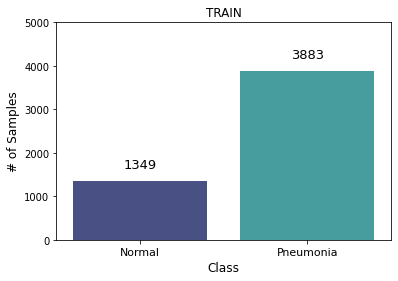

In [ ]:
plt.figure(figsize=(6,4))

ax = sns.countplot(x='class', data=df_train, palette="mako")

plt.xlabel("Class", fontsize= 12)
plt.ylabel("# of Samples", fontsize= 12)
plt.title("TRAIN")
plt.ylim(0,5000)
plt.xticks([0,1], ['Normal', 'Pneumonia'], fontsize = 11)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.30, p.get_height()+300), fontsize = 13)
    
plt.show()

In [ ]:
#visualització de dades de test
df_test

,class,image
0,Normal,/content/chest_xray/test/NORMAL/NORMAL-6703189-0001.jpeg
1,Normal,/content/chest_xray/test/NORMAL/NORMAL-5498455-0001.jpeg
2,Normal,/content/chest_xray/test/NORMAL/NORMAL-4172448-0001.jpeg
3,Normal,/content/chest_xray/test/NORMAL/NORMAL-9799657-0001.jpeg
4,Normal,/content/chest_xray/test/NORMAL/NORMAL-5402107-0001.jpeg
...,...,...
619,Pneumonia,/content/chest_xray/test/PNEUMONIA/BACTERIA-518323-0001.jpeg
620,Pneumonia,/content/chest_xray/test/PNEUMONIA/VIRUS-9564688-0001.jpeg
621,Pneumonia,/content/chest_xray/test/PNEUMONIA/BACTERIA-2131702-0003.jpeg
622,Pneumonia,/content/chest_xray/test/PNEUMONIA/BACTERIA-1768914-0001.jpeg


In [ ]:
#nombre de imatges de cada classe a test
df_test.groupby(['class']).count()

,image
class,
Normal,234
Pneumonia,390


In [ ]:
#ordenació de les imatges de train i test
df_train=df_train.sort_values('image',ignore_index=True)
df_test=df_test.sort_values('image',ignore_index=True)

In [ ]:
df_train

,class,image
0,Normal,/content/chest_xray/train/NORMAL/NORMAL-1003233-0001.jpeg
1,Normal,/content/chest_xray/train/NORMAL/NORMAL-1012843-0001.jpeg
2,Normal,/content/chest_xray/train/NORMAL/NORMAL-1014768-0001.jpeg
3,Normal,/content/chest_xray/train/NORMAL/NORMAL-1023731-0001.jpeg
4,Normal,/content/chest_xray/train/NORMAL/NORMAL-1029510-0001.jpeg
...,...,...
5227,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-9934736-0003.jpeg
5228,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-9947411-0002.jpeg
5229,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-9962961-0002.jpeg
5230,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-9963654-0001.jpeg


In [ ]:
#creació del conjunt de dades de validació (val)
train_df, val_df = train_test_split(df_train, test_size = 0.20, random_state = SEED, stratify = df_train['class'])

In [ ]:
#visualització de dades de train després de la ordenació i del split
train_df

,class,image
3566,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-8718799-0001.jpeg
2866,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-6295192-0003.jpeg
2681,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-5615122-0001.jpeg
1199,Normal,/content/chest_xray/train/NORMAL/NORMAL-9031828-0001.jpeg
4619,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-5822550-0001.jpeg
...,...,...
3476,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-8467199-0001.jpeg
678,Normal,/content/chest_xray/train/NORMAL/NORMAL-5634312-0001.jpeg
1560,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-1797366-0001.jpeg
2769,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-5965088-0001.jpeg


In [ ]:
#nombre de imatges de cada classe de train després del split
train_df.groupby(['class']).count()

,image
class,
Normal,1079
Pneumonia,3106


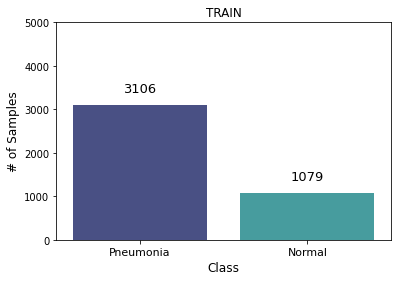

In [ ]:
plt.figure(figsize=(6,4))

ax = sns.countplot(x='class', data=train_df, palette="mako")

plt.xlabel("Class", fontsize= 12)
plt.ylabel("# of Samples", fontsize= 12)
plt.title("TRAIN")
plt.ylim(0,5000)
plt.xticks([0,1], ['Pneumonia', 'Normal'], fontsize = 11)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.30, p.get_height()+300), fontsize = 13)
    
plt.show()

In [ ]:
#visualització de dades de val
val_df

,class,image
2945,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-654117-0001.jpeg
4878,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-7603659-0001.jpeg
3177,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-7512869-0002.jpeg
972,Normal,/content/chest_xray/train/NORMAL/NORMAL-7436212-0002.jpeg
3059,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-7022864-0004.jpeg
...,...,...
253,Normal,/content/chest_xray/train/NORMAL/NORMAL-2699389-0002.jpeg
4315,Pneumonia,/content/chest_xray/train/PNEUMONIA/VIRUS-3896078-0002.jpeg
687,Normal,/content/chest_xray/train/NORMAL/NORMAL-566227-0001.jpeg
3417,Pneumonia,/content/chest_xray/train/PNEUMONIA/BACTERIA-8313249-0001.jpeg


In [ ]:
#nombre de imatges de cada classe de val després del split
val_df.groupby(['class']).count()

,image
class,
Normal,270
Pneumonia,777


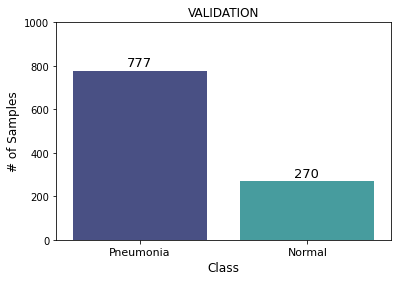

In [ ]:
plt.figure(figsize=(6,4))

ax = sns.countplot(x='class', data=val_df, palette="mako")

plt.xlabel("Class", fontsize= 12)
plt.ylabel("# of Samples", fontsize= 12)
plt.title("VALIDATION")
plt.ylim(0,1000)
plt.xticks([0,1], ['Pneumonia', 'Normal'], fontsize = 11)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.32, p.get_height()+20), fontsize = 13)
    
plt.show()

In [ ]:
#visualització de dades de train després de la ordenació 
df_test

,class,image
0,Normal,/content/chest_xray/test/NORMAL/NORMAL-1049278-0001.jpeg
1,Normal,/content/chest_xray/test/NORMAL/NORMAL-1110860-0001.jpeg
2,Normal,/content/chest_xray/test/NORMAL/NORMAL-11419-0001.jpeg
3,Normal,/content/chest_xray/test/NORMAL/NORMAL-115218-0001.jpeg
4,Normal,/content/chest_xray/test/NORMAL/NORMAL-1160949-0001.jpeg
...,...,...
619,Pneumonia,/content/chest_xray/test/PNEUMONIA/VIRUS-9584831-0001.jpeg
620,Pneumonia,/content/chest_xray/test/PNEUMONIA/VIRUS-9671740-0001.jpeg
621,Pneumonia,/content/chest_xray/test/PNEUMONIA/VIRUS-9783315-0001.jpeg
622,Pneumonia,/content/chest_xray/test/PNEUMONIA/VIRUS-9890836-0001.jpeg


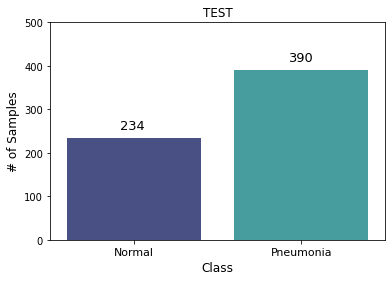

In [ ]:
plt.figure(figsize=(6,4))

ax = sns.countplot(x='class', data=df_test, palette="mako")

plt.xlabel("Class", fontsize= 12)
plt.ylabel("# of Samples", fontsize= 12)
plt.title("TEST")
plt.ylim(0,500)
plt.xticks([0,1], ['Normal', 'Pneumonia'], fontsize = 11)

for p in ax.patches:
    ax.annotate((p.get_height()), (p.get_x()+0.32, p.get_height()+20), fontsize = 13)
    
plt.show()

# <a id="8">Balanceig de Dades</a> 

In [ ]:
#nombre total d'imatges de train
TRAIN_IMG_COUNT=train_df['class'].count()
print("Training images count: " + str(TRAIN_IMG_COUNT))

Training images count: 4185


In [ ]:
#nombre d'imatges de train per a cada classe
COUNT_NORMAL = 1079
print("Normal images count in training set: " + str(COUNT_NORMAL))

COUNT_PNEUMONIA = 3106
print("Pneumonia images count in training set: " + str(COUNT_PNEUMONIA))

Normal images count in training set: 1079
Pneumonia images count in training set: 3106


In [ ]:
#càlcul del biaix inicial
initial_bias = np.log([COUNT_PNEUMONIA/COUNT_NORMAL])
initial_bias

array([1.05730104])

In [ ]:
#càlcul de ponderacions per tal d'equilibrar les classe en l'entrenament
weight_for_0 = (1 / COUNT_NORMAL)*(TRAIN_IMG_COUNT)/2.0 
weight_for_1 = (1 / COUNT_PNEUMONIA)*(TRAIN_IMG_COUNT)/2.0

class_weight = {0: weight_for_0, 1: weight_for_1}

print('Weight for class 0: {:.2f}'.format(weight_for_0))
print('Weight for class 1: {:.2f}'.format(weight_for_1))

Weight for class 0: 1.94
Weight for class 1: 0.67


In [ ]:
#llegir les imatges i canviar el format per entrenar correctament 

train_datagen = ImageDataGenerator(rescale=1/255.,
                                  zoom_range = 0.1,
                                  #rotation_range = 0.1,
                                  width_shift_range = 0.1,
                                  height_shift_range = 0.1)

val_datagen = ImageDataGenerator(rescale=1/255.)

ds_train = train_datagen.flow_from_dataframe(train_df,
                                             #directory=train_path, #dataframe contains the full paths
                                             x_col = 'image',
                                             y_col = 'class',
                                             target_size = (IMG_SIZE, IMG_SIZE),
                                             class_mode = 'categorical',
                                             batch_size = BATCH,
                                             seed = SEED)

ds_val = val_datagen.flow_from_dataframe(val_df,
                                            #directory=train_path,
                                            x_col = 'image',
                                            y_col = 'class',
                                            target_size = (IMG_SIZE, IMG_SIZE),
                                            class_mode = 'categorical',
                                            batch_size = BATCH,
                                            seed = SEED)

ds_test = val_datagen.flow_from_dataframe(df_test,
                                            #directory=test_path,
                                            x_col = 'image',
                                            y_col = 'class',
                                            target_size = (IMG_SIZE, IMG_SIZE),
                                            class_mode = 'categorical',
                                            batch_size = 1,
                                            shuffle = False)

Found 4185 validated image filenames belonging to 2 classes.
Found 1047 validated image filenames belonging to 2 classes.
Found 624 validated image filenames belonging to 2 classes.


# <a id="8">Entrenament del Model</a> 

In [ ]:
# Definir els paràmetres del model
img_width = 224
img_height = 224
epochs = 10

params = {
    'dim': (img_width, img_height),
    'batch_size': 5,
    'n_classes': 2,
    'n_channels': 3,
    'shuffle': True,
}

In [ ]:
#llegir el model prèviament entrenat
model = keras.models.load_model('/content/drive/MyDrive/Colab Notebooks/TFG/model_MobileNet_balanced.h5')

In [ ]:
#avaluació del model amb les dades de val
score = model.evaluate(ds_val, steps = len(val_df)/BATCH, verbose = 0)
print('Val loss:', score[0])
print('Val accuracy:', score[1])

Val loss: 0.036750923842191696
Val accuracy: 0.9894937872886658


In [ ]:
#avaluació del model amb les dades de test
score = model.evaluate(ds_test, steps = len(df_test), verbose = 0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 0.14105497300624847
Test accuracy: 0.9375


# <a id="8">Mètriques d'avaluació</a> 

In [ ]:
#definició de classe 'Normal' com a 0 i 'Pneumonia' com a 1
num_label = {'Normal': 0, 'Pneumonia' : 1}
Y_test = df_test['class'].copy().map(num_label).astype('int')

In [ ]:
#visualització de indexos de les dades de test de la 220 a la 250
Y_test[220:250]

220    0
221    0
222    0
223    0
224    0
225    0
226    0
227    0
228    0
229    0
230    0
231    0
232    0
233    0
234    1
235    1
236    1
237    1
238    1
239    1
240    1
241    1
242    1
243    1
244    1
245    1
246    1
247    1
248    1
249    1
Name: class, dtype: int64

In [ ]:
#prediccions del model
ds_test.reset()
predictions = model.predict(ds_test, steps=len(ds_test), verbose=0)
pred_labels= np.where(predictions[: , 1]>0.5, 1, 0)

In [ ]:
predictions[220:250]

array([[9.8516220e-01, 1.4837782e-02],
       [6.2409896e-01, 3.7590101e-01],
       [8.7761241e-01, 1.2238759e-01],
       [2.2385752e-01, 7.7614254e-01],
       [9.2803645e-01, 7.1963571e-02],
       [9.9822432e-01, 1.7756814e-03],
       [9.9984968e-01, 1.5028454e-04],
       [9.9688452e-01, 3.1154319e-03],
       [7.3432249e-01, 2.6567754e-01],
       [9.9749005e-01, 2.5099134e-03],
       [9.3571496e-01, 6.4285040e-02],
       [9.8263657e-01, 1.7363431e-02],
       [4.0834752e-01, 5.9165251e-01],
       [9.9672359e-01, 3.2763863e-03],
       [1.0131691e-05, 9.9998987e-01],
       [6.4098494e-06, 9.9999356e-01],
       [2.5087979e-06, 9.9999750e-01],
       [9.5579080e-06, 9.9999046e-01],
       [5.5665822e-07, 9.9999940e-01],
       [7.7256855e-06, 9.9999225e-01],
       [4.0579589e-06, 9.9999595e-01],
       [5.6606491e-06, 9.9999440e-01],
       [6.2595717e-08, 9.9999988e-01],
       [5.2349169e-06, 9.9999475e-01],
       [3.5729373e-04, 9.9964273e-01],
       [2.2734467e-04, 9.

In [ ]:
pred_labels[220:250]

array([0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1])

### MATRIU DE CONFUSIÓ

In [ ]:
#exactitud de dades de test
print("Test Accuracy: ", accuracy_score(Y_test, pred_labels))

Test Accuracy:  0.9375


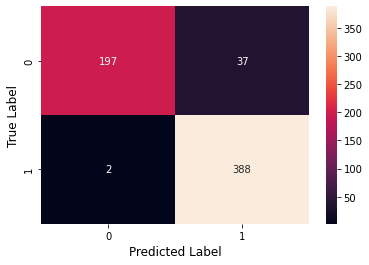

In [ ]:
confusion_matrix = metrics.confusion_matrix(Y_test, pred_labels)
sns.heatmap(confusion_matrix, annot=True, fmt="d")

plt.xlabel("Predicted Label", fontsize= 12)
plt.ylabel("True Label", fontsize= 12)

plt.show()

In [ ]:
print(metrics.classification_report(Y_test, pred_labels, labels = [0, 1]))

              precision    recall  f1-score   support

           0       0.99      0.84      0.91       234
           1       0.91      0.99      0.95       390

    accuracy                           0.94       624
   macro avg       0.95      0.92      0.93       624
weighted avg       0.94      0.94      0.94       624



- Exactitud: 0.94
- Sensibilidad: 0.99
- Especificidad: 0.84
- Precisión: 0.91

### CORBA ROC

ROC_AUC:  0.9968003506465044


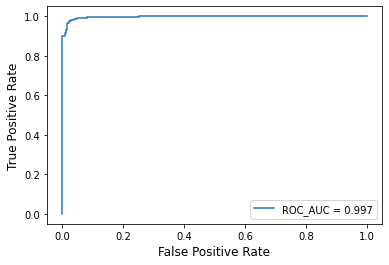

In [ ]:
roc_auc = metrics.roc_auc_score(Y_test, predictions[: , 1])
print('ROC_AUC: ', roc_auc)

fpr, tpr, thresholds = metrics.roc_curve(Y_test, predictions[: , 1])

plt.plot(fpr, tpr, label = 'ROC_AUC = %0.3f' % roc_auc)

plt.xlabel("False Positive Rate", fontsize= 12)
plt.ylabel("True Positive Rate", fontsize= 12)
plt.legend(loc="lower right")

plt.show()

Probabilitats de les prediccions del model

In [ ]:
y_prob = model.predict(ds_test)
y_prob[220:250]

array([[9.8516220e-01, 1.4837782e-02],
       [6.2409896e-01, 3.7590101e-01],
       [8.7761241e-01, 1.2238759e-01],
       [2.2385752e-01, 7.7614254e-01],
       [9.2803645e-01, 7.1963571e-02],
       [9.9822432e-01, 1.7756814e-03],
       [9.9984968e-01, 1.5028454e-04],
       [9.9688452e-01, 3.1154319e-03],
       [7.3432249e-01, 2.6567754e-01],
       [9.9749005e-01, 2.5099134e-03],
       [9.3571496e-01, 6.4285040e-02],
       [9.8263657e-01, 1.7363431e-02],
       [4.0834752e-01, 5.9165251e-01],
       [9.9672359e-01, 3.2763863e-03],
       [1.0131691e-05, 9.9998987e-01],
       [6.4098494e-06, 9.9999356e-01],
       [2.5087979e-06, 9.9999750e-01],
       [9.5579080e-06, 9.9999046e-01],
       [5.5665822e-07, 9.9999940e-01],
       [7.7256855e-06, 9.9999225e-01],
       [4.0579589e-06, 9.9999595e-01],
       [5.6606491e-06, 9.9999440e-01],
       [6.2595717e-08, 9.9999988e-01],
       [5.2349169e-06, 9.9999475e-01],
       [3.5729373e-04, 9.9964273e-01],
       [2.2734467e-04, 9.

In [ ]:
y_prob[229]

array([0.99749005, 0.00250991], dtype=float32)

In [ ]:
y_prob[200:330]

array([[9.94255006e-01, 5.74495969e-03],
       [3.57011199e-01, 6.42988801e-01],
       [4.41825897e-01, 5.58174133e-01],
       [9.99793231e-01, 2.06769153e-04],
       [9.99307036e-01, 6.92962902e-04],
       [9.79329884e-01, 2.06700806e-02],
       [8.89012456e-01, 1.10987544e-01],
       [9.96572852e-01, 3.42715532e-03],
       [9.96661663e-01, 3.33834719e-03],
       [9.99340832e-01, 6.59123471e-04],
       [9.99962807e-01, 3.72268005e-05],
       [9.28495109e-01, 7.15049133e-02],
       [9.81186867e-01, 1.88131388e-02],
       [2.53794998e-01, 7.46204972e-01],
       [9.98947322e-01, 1.05268380e-03],
       [7.19578385e-01, 2.80421644e-01],
       [6.42985225e-01, 3.57014775e-01],
       [5.61135262e-02, 9.43886459e-01],
       [9.97739315e-01, 2.26067728e-03],
       [7.12229013e-01, 2.87770957e-01],
       [9.85162199e-01, 1.48377819e-02],
       [6.24098957e-01, 3.75901014e-01],
       [8.77612412e-01, 1.22387588e-01],
       [2.23857522e-01, 7.76142538e-01],
       [9.280364

In [ ]:
y_prob[500:624]

array([[6.43436622e-04, 9.99356568e-01],
       [4.02610749e-03, 9.95973885e-01],
       [8.45450850e-04, 9.99154568e-01],
       [8.40152893e-03, 9.91598487e-01],
       [1.07253157e-03, 9.98927414e-01],
       [1.60063482e-05, 9.99984026e-01],
       [3.44294414e-04, 9.99655724e-01],
       [1.29174418e-03, 9.98708248e-01],
       [2.55978829e-03, 9.97440219e-01],
       [1.01982467e-02, 9.89801705e-01],
       [6.42518047e-04, 9.99357522e-01],
       [3.52223334e-03, 9.96477783e-01],
       [1.64560240e-03, 9.98354435e-01],
       [3.26135084e-02, 9.67386544e-01],
       [1.88583901e-04, 9.99811471e-01],
       [9.97188501e-04, 9.99002874e-01],
       [9.51142908e-07, 9.99999046e-01],
       [2.06509307e-02, 9.79349136e-01],
       [3.84065905e-04, 9.99615908e-01],
       [1.19073670e-02, 9.88092601e-01],
       [2.84483959e-03, 9.97155190e-01],
       [1.32324989e-03, 9.98676717e-01],
       [1.01694888e-04, 9.99898314e-01],
       [5.10952494e-04, 9.99489069e-01],
       [2.170257

# <a id="8">Tècniques d'explicabilitat</a>

In [ ]:
#creació de variable amb el conjunt de dades de test
img_width = 224
img_height = 224
n_rows = df_test.shape[0]
Xn_rows = 624 #round(n_rows/208)

plt.figure(figsize=(20, 10))
X_ = np.empty((Xn_rows, img_width, img_height, 3))
Xtrain_ = np.empty((Xn_rows, img_width, img_height, 3))


for i in range(624):
    image = ds_test[i][0][0,:]
    X_[i,:] = image


<Figure size 1440x720 with 0 Axes>

## **Grad-CAM**

In [ ]:
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 43 kB 619 kB/s 


In [ ]:
#importació de paquets necessaris
import numpy as np
from PIL import Image, ImageTk
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.grad_cam import GradCAM
from tf_explain.core.smoothgrad import SmoothGrad
from tf_explain.core.integrated_gradients import IntegratedGradients
import cv2
import matplotlib.pyplot as plt


### IMATGE 577

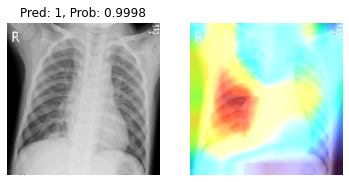

In [ ]:
myindex=577-1
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 2, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 2, 2)
plt.imshow(output)

plt.axis('off')
    
plt.show()

### IMATGES 731,389,523

In [ ]:
list_GradCAM1=[371-1,389-1,523-1]

In [ ]:
XGradCAM1_ = np.empty((len(list_GradCAM1), img_width, img_height, 3))
for i in range(len(list_GradCAM1)):
    image = ds_test[list_GradCAM1[i]][0][0,:]
    XGradCAM1_[i,:] = image


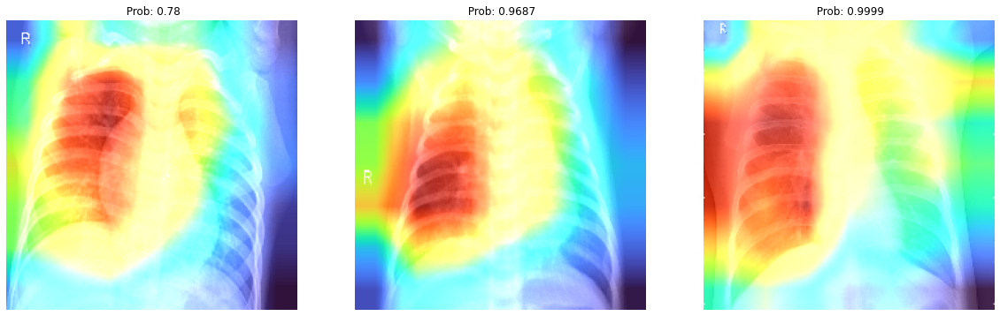

In [ ]:
XGradCAM1_ = np.empty((len(list_GradCAM1), img_width, img_height, 3))
plt.figure(figsize=(20, 20))

for i in range(len(list_GradCAM1)):
    
    image = ds_test[list_GradCAM1[i]][0][0,:]
    XGradCAM1_[i,:] = image
    X[0,:] = image
    y_prob = model.predict(X)
    y_classes = y_prob.argmax(axis=-1)
    
    pred_class = y_classes[0]
    pred_prob = y_prob[0][y_classes[0]]
    title = f' Prob: {pred_prob:.4}'
  
  
    output=0
    explainer = GradCAM()
    output= explainer.explain(
        validation_data=(X, None),
        model=model,
        class_index=y_classes[0],
        colormap=cv2.COLORMAP_TURBO
    )

    plt.subplot(1, 3, i+1)
    plt.title(title)
    plt.imshow(output)
    plt.axis('off')
    
plt.show()


### IMTAGES 274,344,378

In [ ]:
list_GradCAM2=[274-1,344-1,378-1]

In [ ]:
XGradCAM2_ = np.empty((len(list_GradCAM2), img_width, img_height, 3))
for i in range(len(list_GradCAM2)):
    image = ds_test[list_GradCAM2[i]][0][0,:]
    XGradCAM2_[i,:] = image


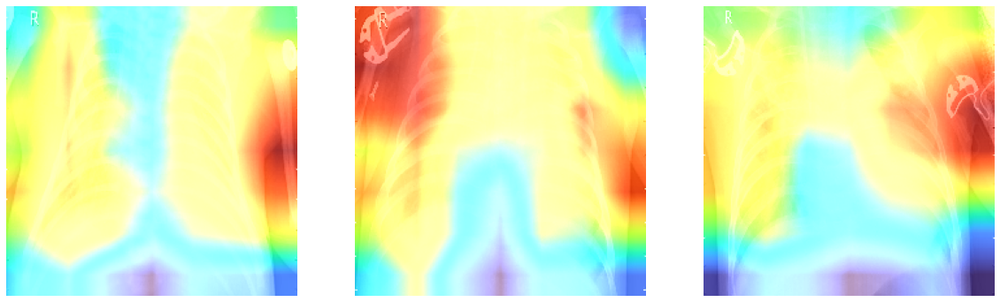

In [ ]:
XGradCAM2_ = np.empty((len(list_GradCAM2), img_width, img_height, 3))
plt.figure(figsize=(20, 20))


for i in range(len(list_GradCAM2)):
    
    image = ds_test[list_GradCAM2[i]][0][0,:]
    XGradCAM2_[i,:] = image
    X[0,:] = image
    y_prob = model.predict(X)
    y_classes = y_prob.argmax(axis=-1)
    
    pred_class = y_classes[0]
    pred_prob = y_prob[0][y_classes[0]]
    title = f' Prob: {pred_prob:.4}'

    output=0
    explainer = GradCAM()
    output= explainer.explain(
        validation_data=(X, None),
        model=model,
        class_index=y_classes[0],
        colormap=cv2.COLORMAP_TURBO
    )
    
    plt.subplot(1, 3, i+1)
    plt.imshow(output)
    plt.axis('off')

      
plt.show()


### IMTAGES 188,18,229

In [ ]:
list_GradCAM3=[188-1,18-1,229-1]

In [ ]:
XGradCAM3_ = np.empty((len(list_GradCAM3), img_width, img_height, 3))
for i in range(len(list_GradCAM3)):
    image = ds_test[list_GradCAM3[i]][0][0,:]
    XGradCAM3_[i,:] = image


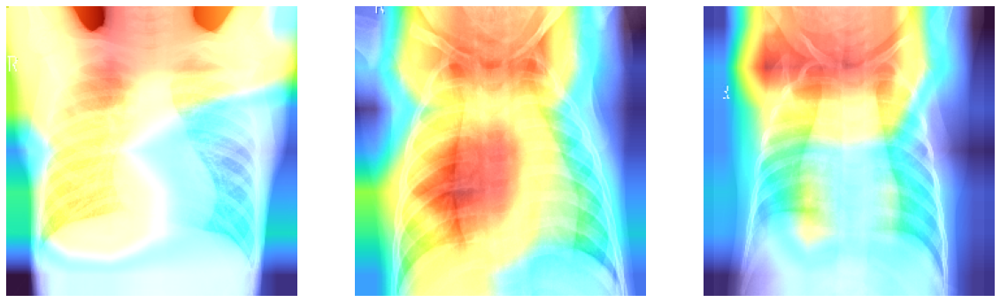

In [ ]:
XGradCAM3_ = np.empty((len(list_GradCAM3), img_width, img_height, 3))

plt.figure(figsize=(20, 20))

for i in range(len(list_GradCAM2)):
    
    image = ds_test[list_GradCAM3[i]][0][0,:]
    XGradCAM3_[i,:] = image
    X[0,:] = image
    y_prob = model.predict(X)
    y_classes = y_prob.argmax(axis=-1)
    
    pred_class = y_classes[0]
    pred_prob = y_prob[0][y_classes[0]]
    title = f' Prob: {pred_prob:.4}'
  
    output=0
    explainer = GradCAM()
    output= explainer.explain(
        validation_data=(X, None),
        model=model,
        class_index=y_classes[0],
        colormap=cv2.COLORMAP_TURBO
    )
    
    plt.subplot(1, 3, i+1)
    plt.imshow(output)
    plt.axis('off')

      
plt.show()


## **SHAP**

In [ ]:
!pip install shap

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 564 kB 6.4 MB/s 


In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

### Shap.maskers.Image

blur(200,200)

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   1%|          | 1/135 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   2%|▏         | 3/135 [00:59<24:38, 11.20s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   3%|▎         | 4/135 [01:21<34:03, 15.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▎         | 5/135 [01:44<39:36, 18.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▍         | 6/135 [02:10<45:06, 20.98s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 7/135 [02:35<47:35, 22.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▌         | 8/135 [03:00<49:07, 23.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   7%|▋         | 9/135 [03:25<50:03, 23.84s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   7%|▋         | 10/135 [03:48<49:17, 23.66s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   8%|▊         | 11/135 [04:13<49:45, 24.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   9%|▉         | 12/135 [04:38<49:33, 24.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|▉         | 13/135 [04:58<46:36, 22.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 14/135 [05:21<46:14, 22.93s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█         | 15/135 [05:42<44:40, 22.33s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  12%|█▏        | 16/135 [06:02<43:20, 21.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  13%|█▎        | 17/135 [06:23<42:01, 21.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  13%|█▎        | 18/135 [06:44<41:40, 21.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▍        | 19/135 [07:04<40:39, 21.03s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  15%|█▍        | 20/135 [07:24<39:48, 20.77s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▌        | 21/135 [07:45<39:25, 20.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▋        | 22/135 [08:06<38:58, 20.70s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  17%|█▋        | 23/135 [08:26<38:19, 20.53s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  18%|█▊        | 24/135 [08:46<37:42, 20.39s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▊        | 25/135 [09:06<37:25, 20.41s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▉        | 26/135 [09:27<37:22, 20.57s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 27/135 [09:50<37:57, 21.09s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██        | 28/135 [10:10<37:27, 21.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██▏       | 29/135 [10:32<37:13, 21.07s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▏       | 30/135 [10:53<36:56, 21.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  23%|██▎       | 31/135 [11:14<36:52, 21.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▎       | 32/135 [11:37<37:15, 21.70s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▍       | 33/135 [11:59<36:54, 21.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 34/135 [12:21<36:49, 21.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▌       | 35/135 [12:43<36:24, 21.84s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  27%|██▋       | 36/135 [13:05<36:09, 21.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  27%|██▋       | 37/135 [13:26<35:31, 21.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  28%|██▊       | 38/135 [13:47<34:49, 21.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  29%|██▉       | 39/135 [14:08<34:03, 21.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|██▉       | 40/135 [14:31<34:25, 21.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 41/135 [14:53<34:05, 21.76s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  31%|███       | 42/135 [15:17<34:40, 22.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  32%|███▏      | 43/135 [15:38<33:52, 22.09s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  33%|███▎      | 44/135 [16:00<33:27, 22.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  33%|███▎      | 45/135 [16:22<32:55, 21.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▍      | 46/135 [16:43<32:27, 21.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▍      | 47/135 [17:05<32:03, 21.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▌      | 48/135 [17:27<31:41, 21.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▋      | 49/135 [17:49<31:24, 21.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  37%|███▋      | 50/135 [18:11<31:03, 21.93s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  38%|███▊      | 51/135 [18:33<30:45, 21.97s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▊      | 52/135 [18:56<30:49, 22.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▉      | 53/135 [19:18<30:09, 22.07s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 54/135 [19:40<29:48, 22.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████      | 55/135 [20:02<29:18, 21.98s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████▏     | 56/135 [20:23<28:51, 21.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  42%|████▏     | 57/135 [20:47<29:10, 22.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  43%|████▎     | 58/135 [21:09<28:48, 22.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▎     | 59/135 [21:32<28:32, 22.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 60/135 [21:54<27:58, 22.39s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 61/135 [22:17<27:36, 22.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▌     | 62/135 [22:39<27:18, 22.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  47%|████▋     | 63/135 [23:02<27:10, 22.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  47%|████▋     | 64/135 [23:28<27:51, 23.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  48%|████▊     | 65/135 [23:50<27:04, 23.20s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  49%|████▉     | 66/135 [24:12<26:05, 22.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|████▉     | 67/135 [24:34<25:39, 22.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 68/135 [24:59<26:03, 23.34s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████     | 69/135 [25:22<25:32, 23.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  52%|█████▏    | 70/135 [25:44<24:41, 22.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  53%|█████▎    | 71/135 [26:08<24:34, 23.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  53%|█████▎    | 72/135 [26:30<23:55, 22.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▍    | 73/135 [26:52<23:20, 22.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▍    | 74/135 [27:14<22:47, 22.41s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▌    | 75/135 [27:36<22:20, 22.34s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▋    | 76/135 [27:57<21:35, 21.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  57%|█████▋    | 77/135 [28:18<21:01, 21.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  58%|█████▊    | 78/135 [28:40<20:43, 21.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▊    | 79/135 [29:02<20:11, 21.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▉    | 80/135 [29:23<19:41, 21.48s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 81/135 [29:44<19:20, 21.49s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████    | 82/135 [30:06<19:05, 21.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████▏   | 83/135 [30:28<18:50, 21.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  62%|██████▏   | 84/135 [30:51<18:44, 22.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  63%|██████▎   | 85/135 [31:13<18:21, 22.02s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▎   | 86/135 [31:38<18:39, 22.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▍   | 87/135 [32:01<18:20, 22.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 88/135 [32:23<17:42, 22.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▌   | 89/135 [32:45<17:11, 22.42s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  67%|██████▋   | 90/135 [33:07<16:46, 22.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  67%|██████▋   | 91/135 [33:30<16:28, 22.47s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  68%|██████▊   | 92/135 [33:53<16:18, 22.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▉   | 93/135 [34:15<15:47, 22.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|██████▉   | 94/135 [34:37<15:16, 22.35s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 95/135 [34:59<14:52, 22.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  71%|███████   | 96/135 [35:21<14:26, 22.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  72%|███████▏  | 97/135 [35:44<14:05, 22.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  73%|███████▎  | 98/135 [36:06<13:45, 22.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  73%|███████▎  | 99/135 [36:30<13:38, 22.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▍  | 100/135 [36:52<13:14, 22.70s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▍  | 101/135 [37:17<13:06, 23.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▌  | 102/135 [37:39<12:32, 22.80s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▋  | 103/135 [38:01<12:09, 22.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  77%|███████▋  | 104/135 [38:24<11:42, 22.65s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  78%|███████▊  | 105/135 [38:46<11:13, 22.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▊  | 106/135 [39:08<10:46, 22.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▉  | 107/135 [39:30<10:26, 22.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 108/135 [39:53<10:08, 22.53s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████  | 109/135 [40:15<09:38, 22.23s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████▏ | 110/135 [40:37<09:19, 22.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▏ | 111/135 [41:01<09:09, 22.91s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  83%|████████▎ | 112/135 [41:24<08:43, 22.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▎ | 113/135 [41:47<08:23, 22.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▍ | 114/135 [42:10<08:01, 22.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 115/135 [42:34<07:47, 23.35s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▌ | 116/135 [42:56<07:13, 22.80s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  87%|████████▋ | 117/135 [43:18<06:46, 22.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  87%|████████▋ | 118/135 [43:42<06:29, 22.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  88%|████████▊ | 119/135 [44:04<06:04, 22.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  89%|████████▉ | 120/135 [44:27<05:43, 22.91s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|████████▉ | 121/135 [44:49<05:17, 22.65s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 122/135 [45:11<04:50, 22.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████ | 123/135 [45:34<04:29, 22.42s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▏| 124/135 [45:57<04:08, 22.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  93%|█████████▎| 125/135 [46:18<03:42, 22.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  93%|█████████▎| 126/135 [46:41<03:20, 22.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 127/135 [47:03<02:58, 22.30s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▍| 128/135 [47:25<02:35, 22.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▌| 129/135 [47:47<02:13, 22.25s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▋| 130/135 [48:11<01:52, 22.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  97%|█████████▋| 131/135 [48:34<01:31, 22.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  98%|█████████▊| 132/135 [48:56<01:07, 22.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▊| 133/135 [49:18<00:45, 22.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▉| 134/135 [49:41<00:22, 22.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 135/135 [50:04<00:00, 22.57s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 136it [50:25, 22.41s/it]


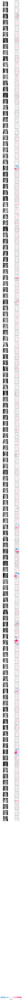

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values = explainer(X_[265:400], max_evals=500, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values)

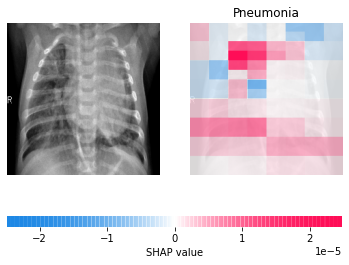

In [ ]:
shap.image_plot(shap_values[124:125])

inpaint_telea

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   1%|          | 1/140 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   2%|▏         | 3/140 [00:57<30:50, 13.50s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   3%|▎         | 4/140 [01:29<48:17, 21.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▎         | 5/140 [02:05<59:56, 26.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▍         | 6/140 [02:32<1:00:12, 26.96s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 7/140 [03:04<1:03:05, 28.46s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▌         | 8/140 [03:34<1:03:40, 28.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▋         | 9/140 [04:01<1:01:49, 28.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   7%|▋         | 10/140 [04:32<1:03:10, 29.16s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   8%|▊         | 11/140 [05:07<1:06:22, 30.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   9%|▊         | 12/140 [05:37<1:05:41, 30.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   9%|▉         | 13/140 [06:06<1:04:06, 30.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 14/140 [06:33<1:01:20, 29.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█         | 15/140 [07:05<1:02:46, 30.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█▏        | 16/140 [07:32<1:00:24, 29.23s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  12%|█▏        | 17/140 [08:00<59:10, 28.87s/it]  

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  13%|█▎        | 18/140 [08:31<59:44, 29.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▎        | 19/140 [09:01<59:26, 29.48s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▍        | 20/140 [09:32<59:59, 30.00s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 21/140 [10:03<1:00:16, 30.39s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▌        | 22/140 [10:33<59:21, 30.18s/it]  

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▋        | 23/140 [11:02<58:25, 29.96s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  17%|█▋        | 24/140 [11:33<58:14, 30.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  18%|█▊        | 25/140 [12:02<57:03, 29.77s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▊        | 26/140 [12:35<58:25, 30.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▉        | 27/140 [13:10<1:00:11, 31.96s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 28/140 [13:42<59:50, 32.06s/it]  

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██        | 29/140 [14:07<55:16, 29.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██▏       | 30/140 [14:41<57:19, 31.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▏       | 31/140 [15:12<56:30, 31.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  23%|██▎       | 32/140 [15:43<56:07, 31.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▎       | 33/140 [16:14<55:12, 30.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▍       | 34/140 [16:44<54:04, 30.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 35/140 [17:14<53:16, 30.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▌       | 36/140 [17:45<53:05, 30.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▋       | 37/140 [18:19<54:34, 31.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  27%|██▋       | 38/140 [18:50<53:26, 31.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  28%|██▊       | 39/140 [19:19<51:36, 30.66s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  29%|██▊       | 40/140 [19:54<53:21, 32.02s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  29%|██▉       | 41/140 [20:30<54:55, 33.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 42/140 [21:05<54:56, 33.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  31%|███       | 43/140 [21:41<55:57, 34.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  31%|███▏      | 44/140 [22:14<54:36, 34.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  32%|███▏      | 45/140 [22:47<53:07, 33.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  33%|███▎      | 46/140 [23:18<51:43, 33.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▎      | 47/140 [23:51<50:57, 32.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▍      | 48/140 [24:26<51:27, 33.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 49/140 [25:01<51:42, 34.10s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▌      | 50/140 [25:38<52:02, 34.70s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▋      | 51/140 [26:10<50:37, 34.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  37%|███▋      | 52/140 [26:38<47:00, 32.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  38%|███▊      | 53/140 [27:12<47:21, 32.66s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▊      | 54/140 [27:40<45:10, 31.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▉      | 55/140 [28:13<45:02, 31.80s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 56/140 [28:49<46:15, 33.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████      | 57/140 [29:24<46:27, 33.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████▏     | 58/140 [29:54<44:35, 32.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  42%|████▏     | 59/140 [30:26<43:42, 32.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  43%|████▎     | 60/140 [30:57<42:48, 32.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▎     | 61/140 [31:28<41:51, 31.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 62/140 [31:58<40:39, 31.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 63/140 [32:27<39:12, 30.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▌     | 64/140 [32:59<39:01, 30.81s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▋     | 65/140 [33:33<39:42, 31.76s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  47%|████▋     | 66/140 [34:02<38:18, 31.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  48%|████▊     | 67/140 [34:42<40:58, 33.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  49%|████▊     | 68/140 [35:19<41:42, 34.76s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  49%|████▉     | 69/140 [35:52<40:35, 34.30s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 70/140 [36:25<39:17, 33.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████     | 71/140 [36:56<37:53, 32.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████▏    | 72/140 [37:31<38:09, 33.67s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  52%|█████▏    | 73/140 [38:13<40:11, 36.00s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  53%|█████▎    | 74/140 [38:51<40:17, 36.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▎    | 75/140 [39:33<41:28, 38.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▍    | 76/140 [40:17<42:43, 40.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 77/140 [41:08<45:27, 43.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▌    | 78/140 [42:01<47:45, 46.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▋    | 79/140 [42:48<47:20, 46.57s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  57%|█████▋    | 80/140 [43:36<46:47, 46.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  58%|█████▊    | 81/140 [44:22<45:54, 46.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▊    | 82/140 [45:11<45:49, 47.41s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▉    | 83/140 [46:06<47:15, 49.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 84/140 [46:59<47:20, 50.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████    | 85/140 [47:52<46:56, 51.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████▏   | 86/140 [48:44<46:22, 51.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  62%|██████▏   | 87/140 [49:41<46:56, 53.14s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  63%|██████▎   | 88/140 [50:35<46:10, 53.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▎   | 89/140 [51:30<45:49, 53.90s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▍   | 90/140 [52:20<43:57, 52.75s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 91/140 [53:16<43:55, 53.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▌   | 92/140 [54:07<42:24, 53.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▋   | 93/140 [54:59<41:15, 52.67s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  67%|██████▋   | 94/140 [55:54<40:50, 53.26s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  68%|██████▊   | 95/140 [56:51<40:45, 54.33s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▊   | 96/140 [57:44<39:41, 54.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▉   | 97/140 [58:31<37:04, 51.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 98/140 [59:25<36:42, 52.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  71%|███████   | 99/140 [1:00:12<34:43, 50.81s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  71%|███████▏  | 100/140 [1:01:02<33:47, 50.69s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  72%|███████▏  | 101/140 [1:02:01<34:38, 53.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  73%|███████▎  | 102/140 [1:02:50<32:57, 52.03s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▎  | 103/140 [1:03:42<31:57, 51.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▍  | 104/140 [1:04:33<30:54, 51.50s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 105/140 [1:05:20<29:19, 50.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▌  | 106/140 [1:06:17<29:37, 52.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▋  | 107/140 [1:07:04<27:58, 50.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  77%|███████▋  | 108/140 [1:07:56<27:16, 51.15s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  78%|███████▊  | 109/140 [1:08:44<25:52, 50.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▊  | 110/140 [1:09:31<24:37, 49.26s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▉  | 111/140 [1:10:17<23:21, 48.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 112/140 [1:11:06<22:34, 48.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████  | 113/140 [1:11:57<22:05, 49.09s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████▏ | 114/140 [1:12:49<21:45, 50.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▏ | 115/140 [1:13:42<21:12, 50.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  83%|████████▎ | 116/140 [1:14:33<20:24, 51.02s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▎ | 117/140 [1:15:24<19:33, 51.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▍ | 118/140 [1:16:32<20:34, 56.11s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 119/140 [1:17:23<19:01, 54.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▌ | 120/140 [1:18:19<18:18, 54.93s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▋ | 121/140 [1:19:13<17:18, 54.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  87%|████████▋ | 122/140 [1:20:01<15:51, 52.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  88%|████████▊ | 123/140 [1:20:46<14:14, 50.25s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  89%|████████▊ | 124/140 [1:21:41<13:49, 51.81s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  89%|████████▉ | 125/140 [1:22:27<12:29, 49.94s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 126/140 [1:23:11<11:15, 48.23s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████ | 127/140 [1:23:45<09:32, 44.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████▏| 128/140 [1:24:28<08:45, 43.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▏| 129/140 [1:25:10<07:55, 43.19s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  93%|█████████▎| 130/140 [1:25:53<07:11, 43.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▎| 131/140 [1:26:27<06:04, 40.48s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 132/140 [1:27:05<05:16, 39.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 133/140 [1:27:44<04:36, 39.46s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▌| 134/140 [1:28:25<04:00, 40.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▋| 135/140 [1:29:06<03:20, 40.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  97%|█████████▋| 136/140 [1:29:45<02:39, 39.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  98%|█████████▊| 137/140 [1:30:23<01:58, 39.43s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▊| 138/140 [1:31:07<01:21, 40.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▉| 139/140 [1:31:48<00:40, 40.86s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 140/140 [1:32:26<00:00, 39.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 141it [1:33:11, 39.94s/it]


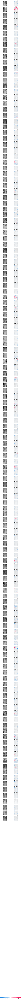

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("inpaint_telea", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values1 = explainer(X_[260:400], max_evals='auto', batch_size='auto', outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values1)

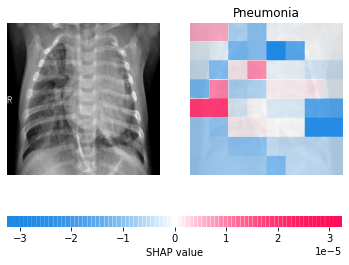

In [ ]:
shap.image_plot(shap_values1[129:130])

inpaint_ns

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   1%|          | 1/140 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   2%|▏         | 3/140 [00:52<29:04, 12.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   3%|▎         | 4/140 [01:19<42:37, 18.80s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▎         | 5/140 [01:51<52:44, 23.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   4%|▍         | 6/140 [02:18<55:29, 24.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 7/140 [02:46<57:00, 25.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▌         | 8/140 [03:12<56:58, 25.90s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   6%|▋         | 9/140 [03:41<58:32, 26.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   7%|▋         | 10/140 [04:09<59:17, 27.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   8%|▊         | 11/140 [04:40<1:01:18, 28.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   9%|▊         | 12/140 [05:09<1:00:35, 28.40s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   9%|▉         | 13/140 [05:35<59:03, 27.90s/it]  

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 14/140 [06:02<58:02, 27.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█         | 15/140 [06:31<57:54, 27.79s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  11%|█▏        | 16/140 [06:58<57:16, 27.71s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  12%|█▏        | 17/140 [07:25<56:27, 27.54s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  13%|█▎        | 18/140 [07:53<56:00, 27.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▎        | 19/140 [08:20<55:27, 27.50s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  14%|█▍        | 20/140 [08:50<56:38, 28.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 21/140 [09:17<54:59, 27.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▌        | 22/140 [09:44<54:22, 27.65s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  16%|█▋        | 23/140 [10:16<56:12, 28.83s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  17%|█▋        | 24/140 [10:43<55:02, 28.47s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  18%|█▊        | 25/140 [11:11<53:45, 28.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▊        | 26/140 [11:41<54:28, 28.67s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  19%|█▉        | 27/140 [12:14<56:38, 30.08s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 28/140 [12:43<55:41, 29.83s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██        | 29/140 [13:07<52:04, 28.15s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  21%|██▏       | 30/140 [13:40<54:10, 29.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  22%|██▏       | 31/140 [14:09<52:59, 29.17s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  23%|██▎       | 32/140 [14:37<52:06, 28.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▎       | 33/140 [15:05<50:51, 28.52s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  24%|██▍       | 34/140 [15:32<49:51, 28.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 35/140 [16:00<49:13, 28.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▌       | 36/140 [16:29<49:27, 28.53s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  26%|██▋       | 37/140 [17:00<49:53, 29.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  27%|██▋       | 38/140 [17:28<48:59, 28.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  28%|██▊       | 39/140 [17:55<47:40, 28.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  29%|██▊       | 40/140 [18:28<49:33, 29.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  29%|██▉       | 41/140 [18:58<49:03, 29.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 42/140 [19:28<48:57, 29.98s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  31%|███       | 43/140 [20:00<49:26, 30.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  31%|███▏      | 44/140 [20:34<50:16, 31.43s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  32%|███▏      | 45/140 [21:03<48:40, 30.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  33%|███▎      | 46/140 [21:32<47:25, 30.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▎      | 47/140 [22:00<45:54, 29.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  34%|███▍      | 48/140 [22:32<46:11, 30.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 49/140 [23:04<46:49, 30.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▌      | 50/140 [23:32<44:59, 29.99s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  36%|███▋      | 51/140 [24:02<44:16, 29.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  37%|███▋      | 52/140 [24:29<42:35, 29.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  38%|███▊      | 53/140 [25:00<42:56, 29.61s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▊      | 54/140 [25:31<43:13, 30.15s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  39%|███▉      | 55/140 [26:00<42:19, 29.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 56/140 [26:32<42:30, 30.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████      | 57/140 [27:03<42:29, 30.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  41%|████▏     | 58/140 [27:31<40:37, 29.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  42%|████▏     | 59/140 [28:01<40:07, 29.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  43%|████▎     | 60/140 [28:29<38:56, 29.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▎     | 61/140 [28:58<38:44, 29.42s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  44%|████▍     | 62/140 [29:27<37:46, 29.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 63/140 [29:54<36:38, 28.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▌     | 64/140 [30:25<37:10, 29.35s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  46%|████▋     | 65/140 [30:54<36:28, 29.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  47%|████▋     | 66/140 [31:24<36:26, 29.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  48%|████▊     | 67/140 [31:57<36:57, 30.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  49%|████▊     | 68/140 [32:28<36:45, 30.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  49%|████▉     | 69/140 [32:58<35:52, 30.32s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 70/140 [33:28<35:15, 30.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████     | 71/140 [33:56<34:14, 29.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  51%|█████▏    | 72/140 [34:24<33:11, 29.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  52%|█████▏    | 73/140 [34:57<33:54, 30.37s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  53%|█████▎    | 74/140 [35:27<33:02, 30.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▎    | 75/140 [35:57<32:43, 30.21s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  54%|█████▍    | 76/140 [36:27<32:03, 30.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 77/140 [36:56<31:06, 29.63s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▌    | 78/140 [37:28<31:38, 30.62s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  56%|█████▋    | 79/140 [37:59<31:05, 30.59s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  57%|█████▋    | 80/140 [38:28<29:59, 29.99s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  58%|█████▊    | 81/140 [38:57<29:14, 29.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▊    | 82/140 [39:24<28:08, 29.12s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  59%|█████▉    | 83/140 [39:56<28:19, 29.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 84/140 [40:25<27:45, 29.74s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████    | 85/140 [40:53<26:43, 29.15s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  61%|██████▏   | 86/140 [41:23<26:19, 29.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  62%|██████▏   | 87/140 [41:56<26:49, 30.38s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  63%|██████▎   | 88/140 [42:28<26:45, 30.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▎   | 89/140 [43:00<26:35, 31.29s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  64%|██████▍   | 90/140 [43:30<25:50, 31.00s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 91/140 [44:04<26:03, 31.91s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▌   | 92/140 [44:36<25:30, 31.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  66%|██████▋   | 93/140 [45:07<24:37, 31.44s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  67%|██████▋   | 94/140 [45:40<24:36, 32.10s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  68%|██████▊   | 95/140 [46:11<23:45, 31.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▊   | 96/140 [46:42<23:03, 31.45s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  69%|██████▉   | 97/140 [47:10<21:54, 30.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 98/140 [47:41<21:30, 30.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  71%|███████   | 99/140 [48:11<20:49, 30.47s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  71%|███████▏  | 100/140 [48:40<19:56, 29.92s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  72%|███████▏  | 101/140 [49:13<20:03, 30.87s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  73%|███████▎  | 102/140 [49:42<19:09, 30.25s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▎  | 103/140 [50:11<18:31, 30.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  74%|███████▍  | 104/140 [50:39<17:39, 29.43s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 105/140 [51:08<16:59, 29.14s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▌  | 106/140 [51:40<17:01, 30.03s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  76%|███████▋  | 107/140 [52:10<16:30, 30.03s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  77%|███████▋  | 108/140 [52:39<15:47, 29.60s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  78%|███████▊  | 109/140 [53:04<14:39, 28.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▊  | 110/140 [53:33<14:17, 28.57s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  79%|███████▉  | 111/140 [53:59<13:25, 27.77s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 112/140 [54:24<12:36, 27.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████  | 113/140 [54:55<12:39, 28.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  81%|████████▏ | 114/140 [55:24<12:22, 28.56s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  82%|████████▏ | 115/140 [55:54<12:03, 28.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  83%|████████▎ | 116/140 [56:26<11:53, 29.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▎ | 117/140 [56:54<11:15, 29.36s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  84%|████████▍ | 118/140 [57:27<11:06, 30.28s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 119/140 [57:55<10:25, 29.78s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▌ | 120/140 [58:28<10:10, 30.51s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  86%|████████▋ | 121/140 [58:56<09:27, 29.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  87%|████████▋ | 122/140 [59:24<08:46, 29.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  88%|████████▊ | 123/140 [59:49<07:57, 28.10s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  89%|████████▊ | 124/140 [1:00:21<07:48, 29.26s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  89%|████████▉ | 125/140 [1:00:52<07:25, 29.68s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 126/140 [1:01:22<06:57, 29.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████ | 127/140 [1:01:51<06:23, 29.49s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  91%|█████████▏| 128/140 [1:02:24<06:07, 30.65s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  92%|█████████▏| 129/140 [1:02:59<05:50, 31.88s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  93%|█████████▎| 130/140 [1:03:35<05:30, 33.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▎| 131/140 [1:04:07<04:54, 32.76s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  94%|█████████▍| 132/140 [1:04:42<04:28, 33.58s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 133/140 [1:05:21<04:05, 35.01s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▌| 134/140 [1:05:58<03:33, 35.64s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  96%|█████████▋| 135/140 [1:06:36<03:02, 36.51s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  97%|█████████▋| 136/140 [1:07:15<02:28, 37.09s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  98%|█████████▊| 137/140 [1:07:53<01:52, 37.57s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▊| 138/140 [1:08:37<01:19, 39.51s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  99%|█████████▉| 139/140 [1:09:19<00:40, 40.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 140/140 [1:09:58<00:00, 39.95s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 141it [1:10:39, 30.28s/it]


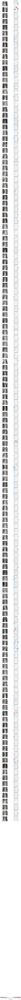

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("inpaint_ns", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values2 = explainer(X_[260:400], max_evals='auto', batch_size='auto', outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values2)

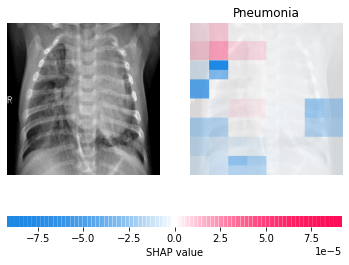

In [ ]:
shap.image_plot(shap_values2[129:130])

### Shap.Explainer

max_evals=50

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


Partition explainer: 21it [01:13,  4.06s/it]


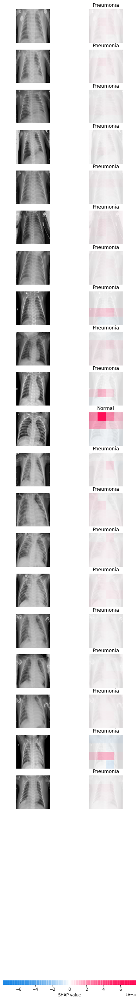

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values3 = explainer(X_[360:380], max_evals=50, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values3)

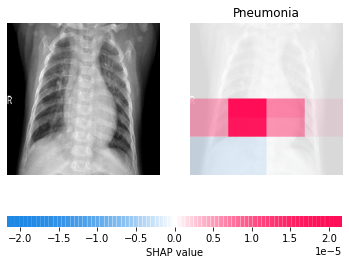

In [ ]:
shap.image_plot(shap_values3[9:10])

max_evals=200

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 3/20 [00:18<01:13,  4.34s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:27<01:39,  6.19s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [00:36<01:46,  7.10s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [00:45<01:48,  7.73s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [00:54<01:45,  8.09s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [01:02<01:39,  8.31s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [01:11<01:33,  8.48s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [01:20<01:26,  8.60s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [01:29<01:17,  8.59s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [01:37<01:08,  8.53s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [01:46<00:59,  8.57s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [01:54<00:51,  8.56s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [02:03<00:43,  8.62s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [02:12<00:34,  8.61s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [02:20<00:25,  8.66s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [02:29<00:17,  8.72s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [02:38<00:08,  8.70s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [02:47<00:00,  8.88s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 21it [02:56,  8.82s/it]


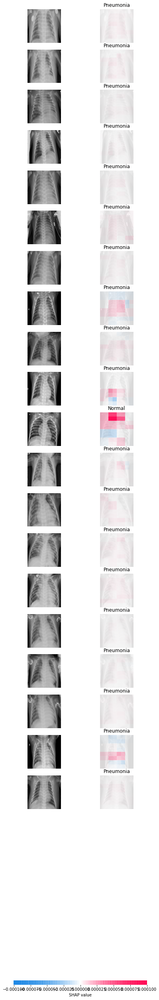

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values4 = explainer(X_[360:380], max_evals=200, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values4)

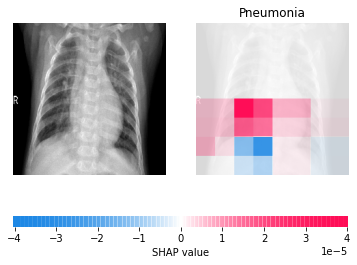

In [ ]:
shap.image_plot(shap_values4[9:10])

max_evals=500

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 3/20 [00:40<02:52, 10.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:59<03:45, 14.07s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [01:19<04:04, 16.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [01:38<04:02, 17.31s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [01:58<03:54, 18.04s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [02:17<03:42, 18.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [02:37<03:27, 18.85s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [02:56<03:09, 18.96s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [03:16<02:53, 19.27s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [03:36<02:36, 19.50s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [03:55<02:15, 19.30s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [04:15<01:57, 19.55s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [04:39<01:43, 20.73s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [04:58<01:21, 20.33s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [05:18<01:00, 20.18s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [05:38<00:40, 20.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [05:58<00:20, 20.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [06:18<00:00, 20.17s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 21it [06:38, 19.92s/it]


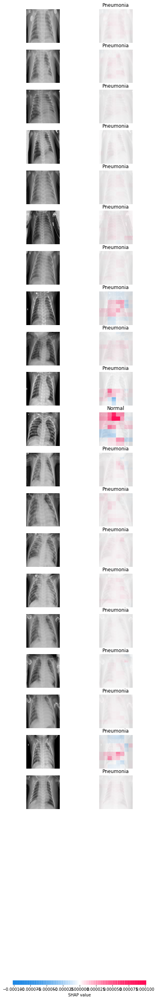

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values5 = explainer(X_[360:380], max_evals=500, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values5)

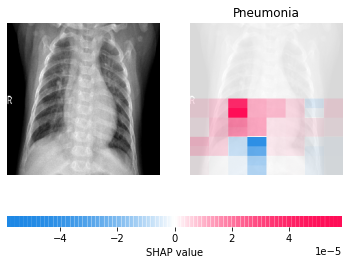

In [ ]:
shap.image_plot(shap_values5[9:10])

max_evals=1000

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 3/20 [01:15<05:20, 18.83s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [01:52<07:04, 26.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [02:31<07:45, 31.02s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [03:10<07:54, 33.92s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [03:48<07:39, 35.33s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [04:27<07:15, 36.26s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [05:05<06:46, 36.99s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [05:45<06:18, 37.89s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [06:23<05:41, 37.98s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [07:01<05:04, 38.01s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [07:46<04:39, 39.97s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [08:24<03:57, 39.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [09:04<03:17, 39.56s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [09:44<02:38, 39.72s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [10:23<01:58, 39.55s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [11:02<01:18, 39.31s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [11:42<00:39, 39.54s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [12:22<00:00, 39.66s/it]

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 21it [13:00, 39.04s/it]


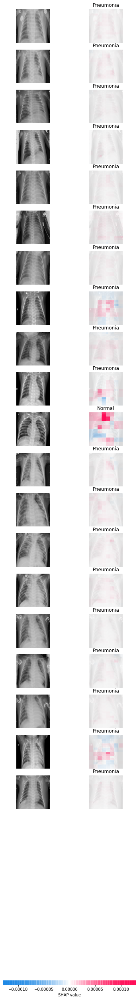

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values6 = explainer(X_[360:380], max_evals=1000, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values6)

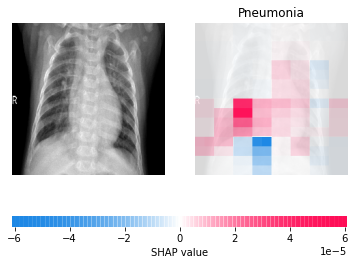

In [ ]:
shap.image_plot(shap_values6[9:10])

batch_size=1

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/98 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 2/20 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:27<01:11,  4.46s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [00:36<01:34,  6.28s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [00:45<01:43,  7.36s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [00:54<01:40,  7.72s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [01:02<01:35,  7.94s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [01:11<01:30,  8.21s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [01:20<01:24,  8.48s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [01:28<01:16,  8.54s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [01:37<01:08,  8.61s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [01:46<01:00,  8.65s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [01:55<00:52,  8.67s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [02:03<00:43,  8.63s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [02:13<00:35,  8.96s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [02:22<00:26,  8.92s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [02:31<00:17,  8.90s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [02:39<00:08,  8.90s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [02:48<00:00,  8.72s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 21it [02:56,  9.31s/it]


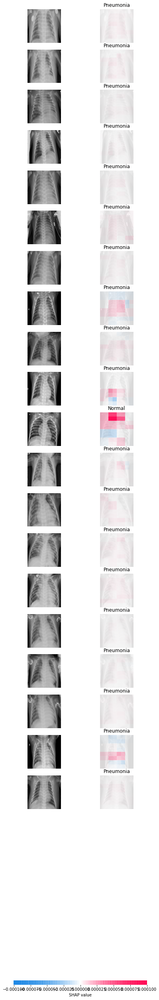

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values7 = explainer(X_[360:380], max_evals=200, batch_size=1, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values7)

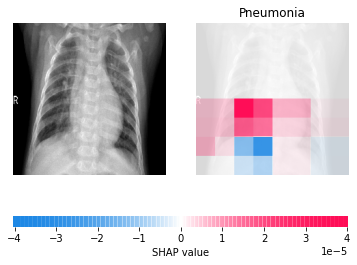

In [ ]:
shap.image_plot(shap_values7[9:10])

batch_size=10

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


Partition explainer:  20%|██        | 4/20 [00:20<00:55,  3.44s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [01:45<00:26,  6.71s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [01:59<00:13,  6.86s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 21it [02:20,  7.39s/it]


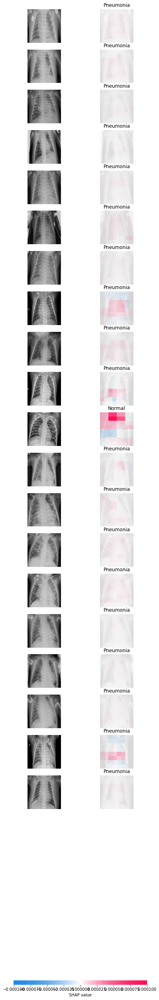

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values8 = explainer(X_[360:380], max_evals=200, batch_size=10, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values8)

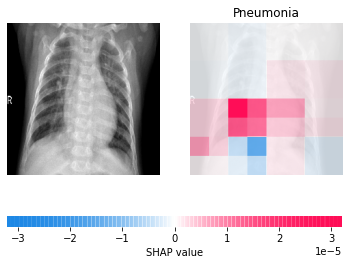

In [ ]:
shap.image_plot(shap_values8[9:10])

batch_size=50

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/98 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  10%|█         | 2/20 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:28<01:15,  4.75s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [00:38<01:41,  6.78s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [00:48<01:51,  7.95s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [00:57<01:49,  8.41s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [01:07<01:46,  8.89s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [01:17<01:40,  9.16s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [01:26<01:32,  9.20s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [01:36<01:24,  9.36s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [01:46<01:16,  9.57s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [01:56<01:07,  9.67s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [02:05<00:57,  9.54s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [02:15<00:48,  9.60s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [02:24<00:37,  9.49s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [02:33<00:28,  9.41s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [02:43<00:19,  9.51s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [02:53<00:09,  9.67s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [03:02<00:00,  9.61s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 21it [03:12, 10.12s/it]


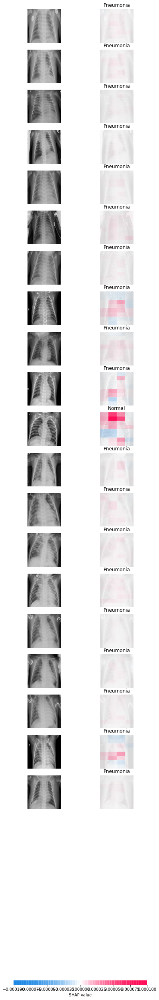

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values9 = explainer(X_[360:380], max_evals=200, batch_size=50, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values9)

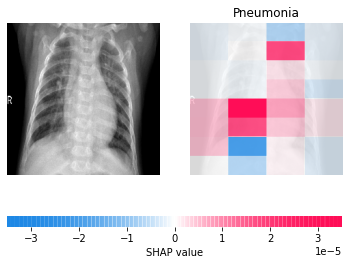

In [ ]:
shap.image_plot(shap_values9[9:10])

batch_size=200

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 3/20 [00:20<01:25,  5.00s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:30<01:55,  7.23s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [00:42<02:13,  8.93s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [00:53<02:12,  9.47s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [01:03<02:06,  9.72s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [01:13<01:58,  9.84s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [01:23<01:49,  9.95s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [01:33<01:39,  9.92s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [01:43<01:30, 10.10s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [01:53<01:19,  9.96s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [02:03<01:10, 10.11s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [02:14<01:01, 10.28s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [02:25<00:52, 10.46s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [02:36<00:42, 10.50s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [02:46<00:31, 10.36s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [02:56<00:20, 10.42s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [03:06<00:10, 10.28s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [03:16<00:00, 10.29s/it]

  0%|          | 0/98 [00:00<?, ?it/s]

Partition explainer: 21it [03:27, 10.37s/it]


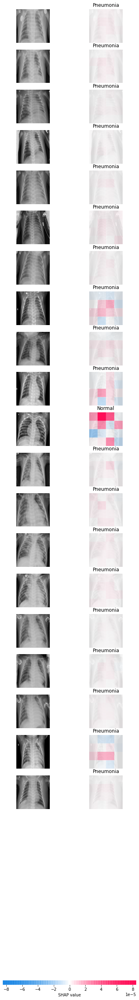

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values10 = explainer(X_[360:380], max_evals=200, batch_size=200, outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values10)

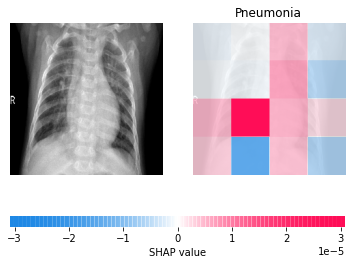

In [ ]:
shap.image_plot(shap_values10[9:10])

max_evals=auto , batch_size=auto

tf.Tensor(
[[5.4955333e-01 4.5044667e-01]
 [9.9812549e-01 1.8745236e-03]
 [9.7115064e-01 2.8849406e-02]
 ...
 [1.8867907e-03 9.9811327e-01]
 [1.3483905e-04 9.9986517e-01]
 [2.9650726e-04 9.9970347e-01]], shape=(624, 2), dtype=float32)


  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:   5%|▌         | 1/20 [00:00<?, ?it/s]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  15%|█▌        | 3/20 [00:31<02:11,  7.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  20%|██        | 4/20 [00:46<02:54, 10.89s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  25%|██▌       | 5/20 [01:02<03:12, 12.82s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  30%|███       | 6/20 [01:17<03:07, 13.39s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  35%|███▌      | 7/20 [01:32<03:03, 14.09s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  40%|████      | 8/20 [01:47<02:52, 14.41s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  45%|████▌     | 9/20 [02:03<02:41, 14.72s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  50%|█████     | 10/20 [02:18<02:29, 14.97s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  55%|█████▌    | 11/20 [02:33<02:15, 15.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  60%|██████    | 12/20 [02:49<02:01, 15.20s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  65%|██████▌   | 13/20 [03:04<01:46, 15.23s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  70%|███████   | 14/20 [03:19<01:30, 15.15s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  75%|███████▌  | 15/20 [03:34<01:15, 15.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  80%|████████  | 16/20 [03:49<01:00, 15.05s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  85%|████████▌ | 17/20 [04:04<00:45, 15.06s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  90%|█████████ | 18/20 [04:20<00:30, 15.22s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer:  95%|█████████▌| 19/20 [04:35<00:15, 15.24s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 100%|██████████| 20/20 [04:50<00:00, 15.13s/it]

  0%|          | 0/248 [00:00<?, ?it/s]

Partition explainer: 21it [05:05, 15.28s/it]


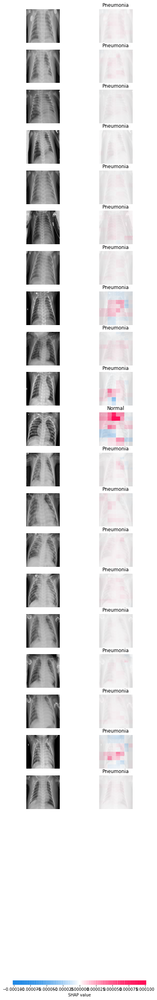

In [ ]:
from tensorflow.keras.applications.resnet50 import preprocess_input
import json
import shap
import tensorflow as tf

def f(X):
    tmp = X.copy()
    #preprocess_input(tmp)
    
    return model(tmp)
#X, y = shap.datasets.imagenet50()
X_= np.float32(X_)


#with open(shap.datasets.cache(url)) as file:
#    class_names = [v[1] for v in json.load(file).values()]

# define a masker that is used to mask out partitions of the input image, this one uses a blurred background

masker = shap.maskers.Image("blur(200,200)", X_[0].shape)

# By default the Partition explainer is used for all  partition explainer
explainer = shap.Explainer(f, masker, output_names=['Normal','Pneumonia'])

# here we use 500 evaluations of the underlying model to estimate the SHAP values
print(f(X_))
shap_values11 = explainer(X_[360:380], max_evals='auto', batch_size='auto', outputs=shap.Explanation.argsort.flip[:1])
shap.image_plot(shap_values11)

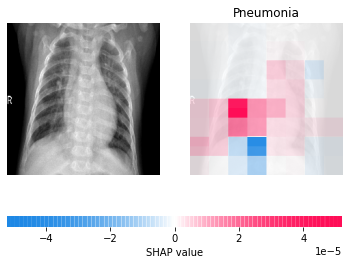

In [ ]:
shap.image_plot(shap_values11[9:10])

## **LIME**

In [ ]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 275 kB 2.3 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=15f3b6d5fe02816664621166e2e4cde8d4a8333ee50a3b619b908befd1b316bb
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [ ]:
#importació de paquets 
import lime
from lime import lime_image
from skimage.io import imread
from skimage.segmentation import mark_boundaries

### IMATGE 310

In [ ]:
import random

from numpy.random import seed
seed(42)

In [ ]:
explainer = lime_image.LimeImageExplainer(random_state=42)

### explainer.explain_instance

num_samples = 5000

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp6 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=5000, distance_metric='cosine', random_seed=42)

  0%|          | 0/5000 [00:00<?, ?it/s]

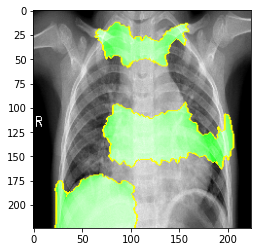

In [ ]:
random.seed(42)
temp, mask = explanationp6.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

num_samples = 1000

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp1 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)

  0%|          | 0/1000 [00:00<?, ?it/s]

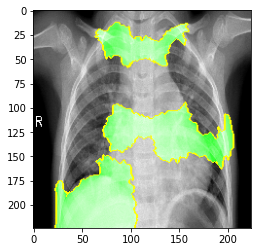

In [ ]:
random.seed(42)
temp, mask = explanationp1.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

num_samples = 100

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp2 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=100, distance_metric='cosine', random_seed=42)

  0%|          | 0/100 [00:00<?, ?it/s]

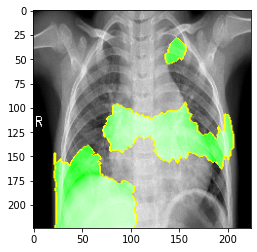

In [ ]:
random.seed(42)
temp, mask = explanationp2.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

num_samples = 15

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp3 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=15, distance_metric='cosine', random_seed=42)

  0%|          | 0/15 [00:00<?, ?it/s]

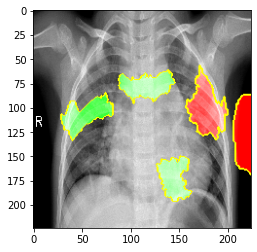

In [ ]:
random.seed(42)
temp, mask = explanationp3.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

distance_metric='cosine'

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp4 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)

  0%|          | 0/1000 [00:00<?, ?it/s]

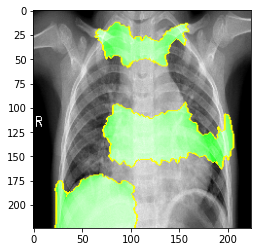

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

distance_metric=None

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp5 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=1000, random_seed=42)

  0%|          | 0/1000 [00:00<?, ?it/s]

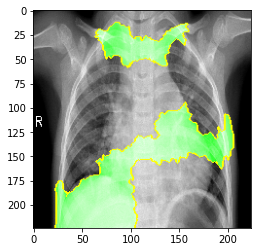

In [ ]:
random.seed(42)
temp, mask = explanationp5.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

In [ ]:
#explicació de la imatge 4
img =X_[310]
explanationp41 = explainer.explain_instance(img, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='euclidean', random_seed=42)

  0%|          | 0/1000 [00:00<?, ?it/s]

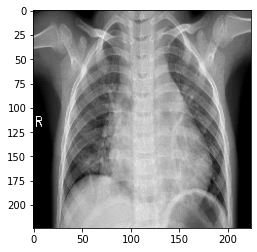

In [ ]:
random.seed(42)
temp, mask = explanationp41.get_image_and_mask(label=1, positive_only=False, num_features=10, hide_rest=False,  min_weight=0.0005)
plt.imshow(mark_boundaries(temp / 1, mask))

### get_image_and_mask

positive_only=False

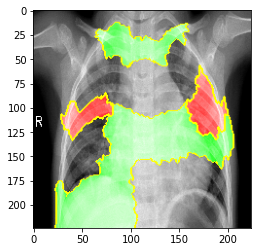

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=8, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

positive_only=True

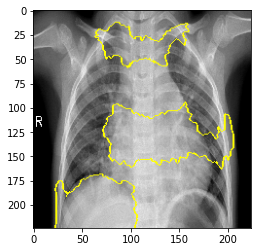

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

num_features=5

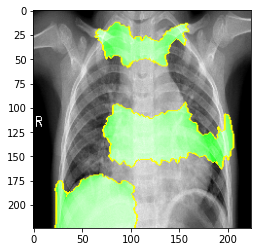

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

num_features=15

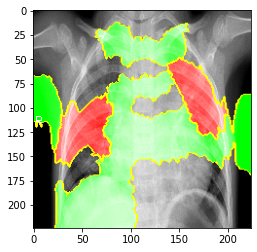

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=15, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

hide_rest=False

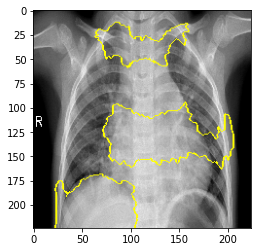

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

hide_rest=True

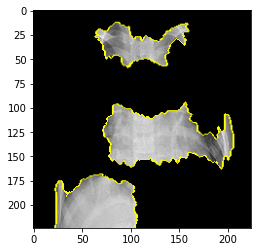

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=True,  min_weight=0.005)
plt.imshow(mark_boundaries(temp / 1, mask))

min_weight=0.00005




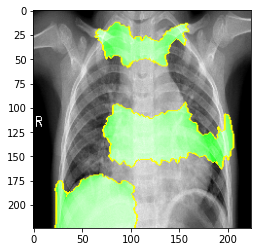

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.00005)
plt.imshow(mark_boundaries(temp / 1, mask))

min_weight=0.025

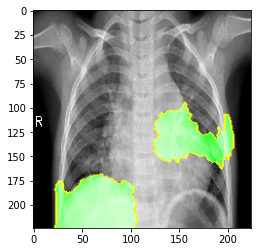

In [ ]:
random.seed(42)
temp, mask = explanationp4.get_image_and_mask(label=1, positive_only=False, num_features=5, hide_rest=False,  min_weight=0.025)
plt.imshow(mark_boundaries(temp / 1, mask))

### heatmap

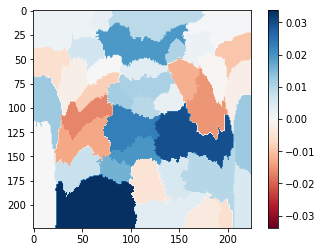

In [ ]:
#Select the same class explained on the figures above.
ind =  1

#Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanationp4.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanationp4.segments) 

#Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()

num_samples=1000 

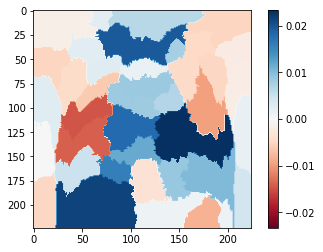

In [ ]:
#Select the same class explained on the figures above.
ind =  1

#Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanationp1.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanationp1.segments) 

#Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()

num_samples=15

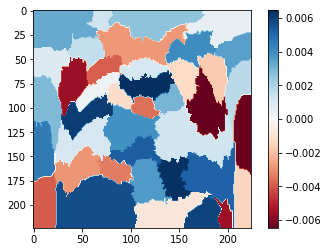

In [ ]:
#Select the same class explained on the figures above.
ind =  1

#Map each explanation weight to the corresponding superpixel
dict_heatmap = dict(explanationp3.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanationp3.segments) 

#Plot. The visualization makes more sense if a symmetrical colorbar is used.
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar()

## **ALTRES TÈCNIQUES**

In [ ]:
#importació de paquets necessaris
import numpy as np
from PIL import Image, ImageTk
from tf_explain.core.activations import ExtractActivations
from tf_explain.core.smoothgrad import SmoothGrad
from tf_explain.core.integrated_gradients import IntegratedGradients
import cv2
import matplotlib.pyplot as plt

img_width = 224
img_height = 224
n_rows = df_test.shape[0]
Xn_rows = 624 #round(n_rows/208)

plt.figure(figsize=(20, 10))
X_ = np.empty((Xn_rows, img_width, img_height, 3))
Xtrain_ = np.empty((Xn_rows, img_width, img_height, 3))

<Figure size 1440x720 with 0 Axes>

In [ ]:
myindex=577-1
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)

### CAM

(-0.5, 223.5, 223.5, -0.5)

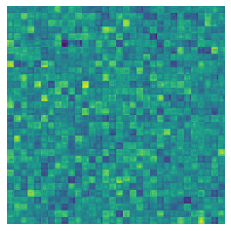

In [ ]:
explainer = ExtractActivations()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    layers_name=["conv_pw_13"] #mteix gradcam
    )
plt.imshow(output)
plt.axis('off')

### SmoothGrad

(-0.5, 223.5, 223.5, -0.5)

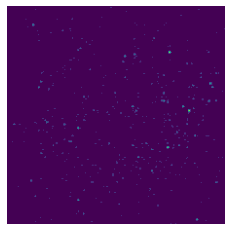

In [ ]:

explainer = SmoothGrad()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    num_samples=20,
    noise=1.,
    class_index=y_classes[0],
    )
    

plt.imshow(output)
plt.axis('off')

### Integrated Gradients

(-0.5, 223.5, 223.5, -0.5)

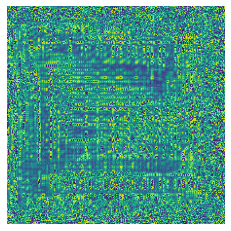

In [ ]:
explainer = IntegratedGradients()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    class_index=y_classes[0],
    n_steps=20
    )
plt.imshow(output)
plt.axis('off')

## **COMPARACIÓ ENTRE LES TÈCNIQUES**

In [ ]:
!pip install tf-explain

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import numpy as np
from PIL import Image, ImageTk
from tf_explain.core.grad_cam import GradCAM
import cv2
import matplotlib.pyplot as plt


In [ ]:
!pip install lime

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import lime
from lime import lime_image
from skimage.io import imread
from skimage.segmentation import mark_boundaries

In [ ]:
import random

from numpy.random import seed
seed(42)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


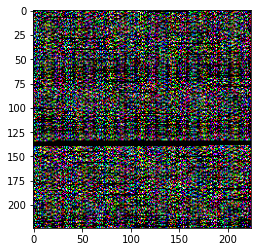

In [ ]:
plt.imshow(X_[267])

  0%|          | 0/1000 [00:00<?, ?it/s]

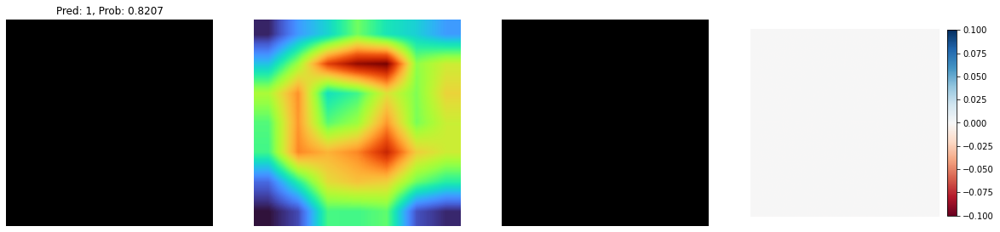

In [ ]:
#nombre de la imatge 
myindex=336-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[336-1]
explanation10 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation10.get_image_and_mask(label=1, positive_only=True, num_features=10, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation10.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation10.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

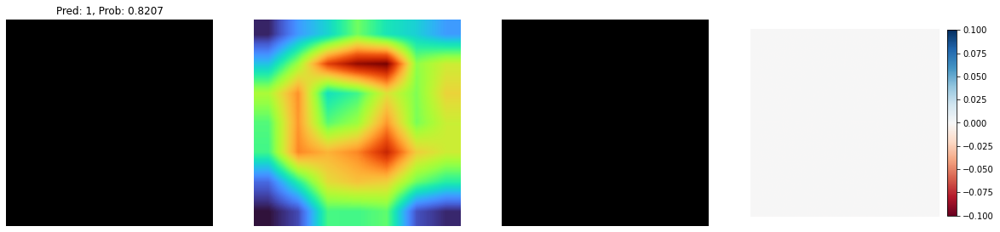

In [ ]:
#nombre de la imatge 
myindex=590-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[590-1]
explanation11 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation11.get_image_and_mask(label=1, positive_only=True, num_features=10, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation11.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation11.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

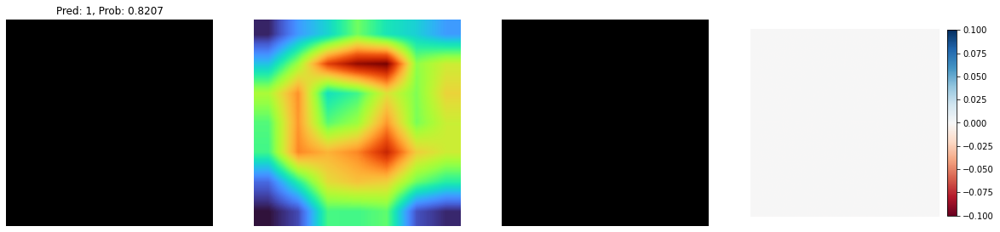

In [ ]:
#nombre de la imatge 
myindex=479-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[479-1]
explanation12 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation12.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation12.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation12.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


  0%|          | 0/1000 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


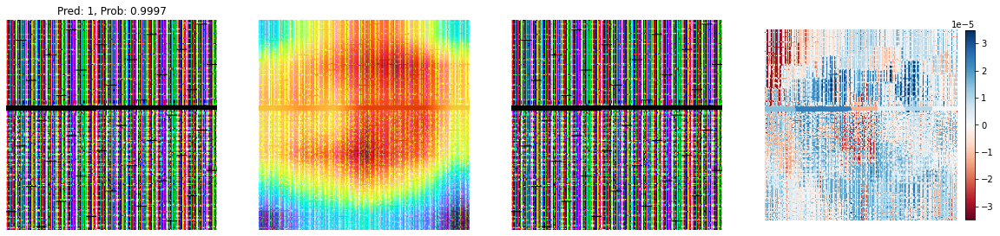

In [ ]:
#nombre de la imatge 
myindex=315-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[315-1]
explanation13 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation13.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation13.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation13.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

In [ ]:
#nombre de la imatge 
myindex=616-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[616-1]
explanation14 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation14.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation14.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation14.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

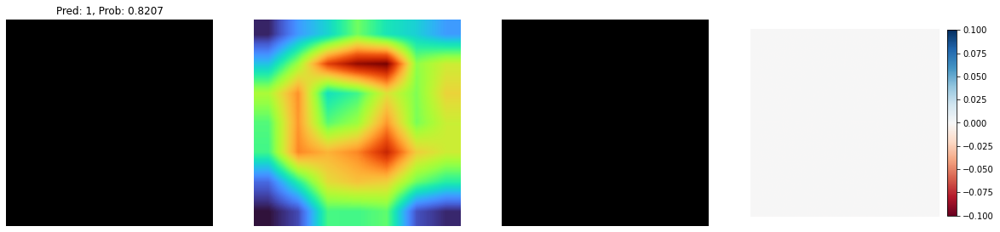

In [ ]:
#nombre de la imatge 
myindex=494-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[494-1]
explanation15 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation15.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation15.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation15.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

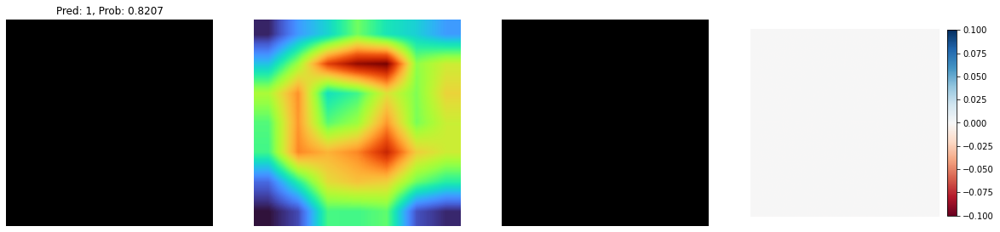

In [ ]:
#nombre de la imatge 
myindex=556-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[556-1]
explanation16 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation16.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation16.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation16.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


  0%|          | 0/1000 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


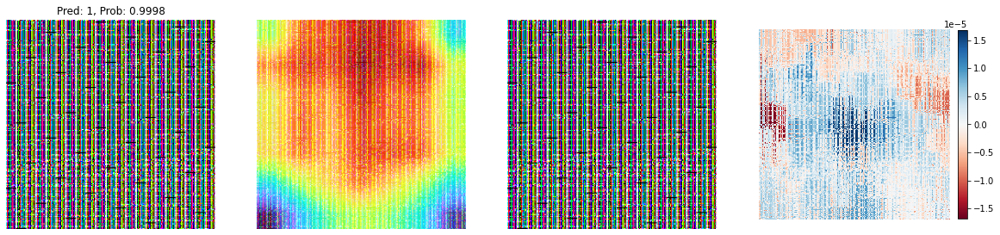

In [ ]:
#nombre de la imatge 
myindex=303-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[303-1]
explanation17 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation17.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation17.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation17.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()

  0%|          | 0/1000 [00:00<?, ?it/s]

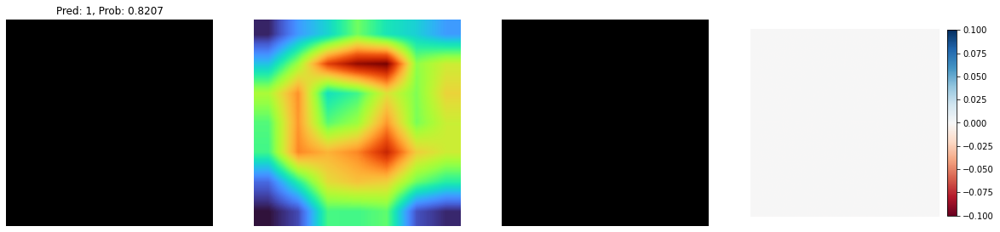

In [ ]:
#nombre de la imatge 
myindex=476-1

random_seed=42

plt.figure(figsize=(20, 20))
X = np.empty((1, img_width, img_height, 3))
X[0,:] = X_[myindex,:]
y_prob = model.predict(X)
y_classes = y_prob.argmax(axis=-1)
    
pred_class = y_classes[0]
pred_prob = y_prob[0][y_classes[0]]
title = f'Pred: {pred_class}, Prob: {pred_prob:.4}'

plt.subplot(1, 4, 1)
plt.title(title)
plt.imshow(X[0])

plt.axis('off')
    
explainer = GradCAM()
output = explainer.explain(
    validation_data=(X, None),
    model=model,
    #layer_name='conv_pw_13',
    class_index=y_classes[0],
    colormap=cv2.COLORMAP_TURBO
    )
    
plt.subplot(1, 4, 2)
plt.imshow(output)

plt.axis('off')

explainer = lime_image.LimeImageExplainer(random_state=42)
img2 =X_[476-1]
explanation18 = explainer.explain_instance(img2, model.predict, top_labels=2, hide_color=0, num_samples=1000, distance_metric='cosine', random_seed=42)
temp, mask = explanation18.get_image_and_mask(label=1, positive_only=True, num_features=5, hide_rest=False,  min_weight=0.0005)

plt.subplot(1, 4, 3)
plt.imshow(mark_boundaries(temp / 1, mask))

plt.axis('off')


ind =  1

dict_heatmap = dict(explanation18.local_exp[ind])
heatmap = np.vectorize(dict_heatmap.get)(explanation18.segments) 


plt.subplot(1, 4, 4)
plt.imshow(heatmap, cmap = 'RdBu', vmin  = -heatmap.max(), vmax = heatmap.max())
plt.colorbar(fraction=0.045, pad=0.04)

plt.axis('off')
    
plt.show()